# AmadeusGPT Demo: MausHaus

- please get an openAI user key: https://platform.openai.com/api-keys.
- We suggest to run the demos locally, but it can be viewed on Google Colab. Some interactive features might not be available.

In [1]:
!pip install --pre amadeusgpt

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.ion()  # Turn on interactive mode

- Let's test that your open AI API Key works:

In [1]:
import os
from dotenv import load_dotenv
load_dotenv('../.env')

mykey = os.getenv("OPENROUTER_API_KEY")

In [2]:
from amadeusgpt.utils.openai_adapter import OpenAIAdapter

client = OpenAIAdapter(api_key=mykey).get_client()

response = client.chat.completions.create(
    model="thudm/glm-z1-32b:free",
    messages=[{"role": "user", "content": "Hello AmadeusGPT"}]
)
print(response.choices[0].message.content)

/Users/akshaypardhanani/Desktop/python-projects/AmadeusGPT/.venv/lib/python3.11/site-packages/cebra/integrations/sklearn/cebra.py:31: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  import pkg_resources
INFO:httpx:HTTP Request: GET https://api.openai.com/v1/models "HTTP/1.1 401 Unauthorized"
INFO:httpx:HTTP Request: GET https://openrouter.ai/api/v1/models "HTTP/1.1 200 OK"
INFO:sentence_transformers.SentenceTransformer:Use pytorch device_name: mps
INFO:sentence_transformers.SentenceTransformer:Load pretrained SentenceTransformer: BAAI/bge-m3
INFO:httpx:HTTP Request: POST https://openrouter.ai/api/v1/chat/completions "HTTP/1.1 200 OK"


Hello! I’m AmadeusGPT, a specialized AI assistant for travel and hospitality. Let me know how I can assist you today—whether you’re planning a trip, need help with bookings, or want to create or refine a travel-related system like the hotel booking example I started earlier. 😊


In [3]:
%matplotlib widget
from amadeusgpt import AMADEUS
import amadeusgpt
from pathlib import Path
from amadeusgpt.utils import parse_result
from amadeusgpt import create_project

## Please upload the demo video and associated files:
- you can grab it from here: https://github.com/AdaptiveMotorControlLab/AmadeusGPT/tree/mwm/docs/examples/MausHaus

In [6]:
scene_frame_number = 400
amadeus_root = Path(amadeusgpt.__file__).parent.parent

kwargs = {
    "keypoint_info.body_orientation_keypoints.neck" : "nose",
    "keypoint_info.body_orientation_keypoints.tail_base" : "tail_base",
    "keypoint_info.body_orientation_keypoints.animal_center" : "neck",
    "keypoint_info.head_orientation_keypoints.nose" : "nose",
    "keypoint_info.head_orientation_keypoints.neck" : "neck",
    "video_info.scene_frame_number" : 100,
}
llm_info = {"llm_info": {"max_tokens": 4096, 
                     "temperature": 0.0, 
                     # let's use the best model by default
                     "gpt_model": "thudm/glm-z1-32b:free",
                     "keep_last_n_messages": 2}
        }

config = create_project(data_folder = "../examples/MausHaus", #check the path to the data folder
                        result_folder = "results",
                        **kwargs,
                        **llm_info,
                        )

amadeus = AMADEUS(config, use_vlm = False)
video_file_paths = amadeus.get_video_file_paths()
print (video_file_paths)   

2025-08-10 11:20:14.947 WARNING streamlit.runtime.scriptrunner_utils.script_run_context: Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-08-10 11:20:14.948 WARNING streamlit.runtime.scriptrunner_utils.script_run_context: Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-08-10 11:20:14.948 WARNING streamlit.runtime.scriptrunner_utils.script_run_context: Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.


Project created at results. Results will be saved to results
The project will load video files (*.mp4) and optionally keypoint files from ../examples/MausHaus
A copy of the project config file is saved at results/config.yaml
{'data_info': {'data_folder': '../examples/MausHaus',
               'result_folder': 'results',
               'video_suffix': '.mp4'},
 'keypoint_info': {'body_orientation_keypoints': {'animal_center': 'neck',
                                                  'neck': 'nose',
                                                  'tail_base': 'tail_base'},
                   'head_orientation_keypoints': {'neck': 'neck',
                                                  'nose': 'nose'},
                   'include_confidence': False,
                   'use_3d': False},
 'llm_info': {'gpt_model': 'thudm/glm-z1-32b:free',
              'keep_last_n_messages': 2,
              'max_tokens': 4096,
              'temperature': 0.0},
 'object_info': {'load_objects_from_disk

## Draw two ROIs by drawing 
- Run the cell below, then click points to make a rectangle, for example, or another shape. Hit ESC when done!
- Then we will ask Q's about what the mouse does...

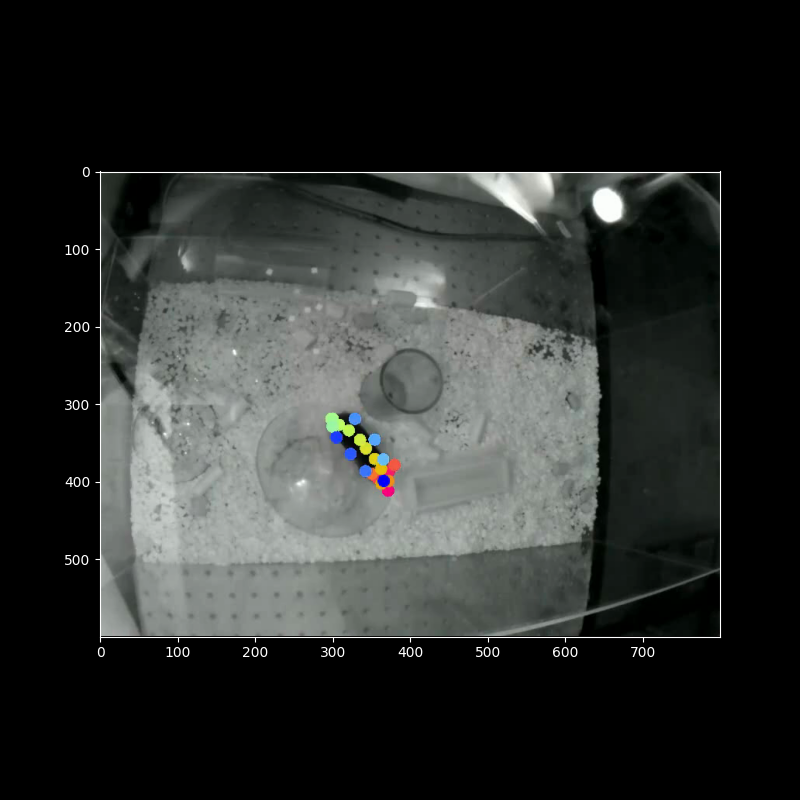

IndexError: list index out of range

IndexError: list index out of range

IndexError: list index out of range

IndexError: list index out of range

In [11]:
behavior_analysis = amadeus.get_behavior_analysis(video_file_path='../examples/MausHaus/maushaus_trimmed.mp4', #check the path to the video file
                                                  keypoint_file_path='../examples/MausHaus/maushaus_trimmed.h5') #check the path to the keypoint file

behavior_analysis.gui_manager.add_roi_from_video_selection()



### Press Esc when you are done drawing each ROI!!

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

doing active forgetting


INFO:httpx:HTTP Request: POST https://openrouter.ai/api/v1/chat/completions "HTTP/1.1 200 OK"


current total cost 0 $
current input tokens 3319
current accumulated tokens 15850


```python
def plot_animal_trajectory(identifier):
    """
    Plot the animal's trajectory using the 'mouse_center' keypoint, colored by time.
    
    Parameters:
    ----------
    identifier: Identifier. Contains information about the video, keypoint and config
    
    Returns:
    -------
    tuple: (figure, axis) containing the trajectory plot
    """
    analysis = create_analysis(identifier)
    keypoints = analysis.get_keypoints()  # Shape: (n_frames, n_individuals, n_kpts, 2)
    frame_rate = analysis.get_frame_rate()
    
    # Get index of 'mouse_center' bodypart
    kpt_names = analysis.get_keypoint_names()
    center_idx = kpt_names.index('mouse_center')
    
    # Extract x,y coordinates for animal_0's center
    # Shape: (n_frames, 1, 1, 2) -> reduce to (n_frames, 2)
    x = keypoints[:, 0, center_idx, 0].flatten()  # (n_frames,)
    y = keypoints[:, 0, center_idx, 1].flatten()  # (n_frames,)
    
    # Calculate time values for coloring
    time = np.arange(len(x)) / frame_rate  # Convert frames to seconds
    
    # Create figure with specified image dimensions
    fig, ax = plt.subplots(figsize=(8, 6))
    
    # Plot trajectory with time-based coloring
    scatter = ax.scatter(x, y, c=time, cmap='viridis', s=10, edgecolors='none')
    
    # Set axis limits to cover full image dimensions
    ax.set_xlim(0, 800)
    ax.set_ylim(600, 0)  # Invert y-axis to match image coordinates
    
    # Add colorbar with time labels
    cbar = plt.colorbar(scatter, ax=ax)
    cbar.set_label('Time (seconds)')
    cbar.set_ticks(np.linspace(0, max(time), 5))
    
    # Add trajectory line
    ax.plot(x, y, color='gray', alpha=0.3, linewidth=0.5)
    
    # Add frame counter annotation
    def update_annotation(frame_idx):
        ax.annotate(f'Frame: {frame_idx}', 
                    xy=(0.05, 0.95), xycoords='axes fraction',
                    xytext=(5, -5), textcoords='offset points',
                    ha='left', va='top')
    
    # Create animation (if needed for video)
    # Note: Animation is commented out as per rule 1 to avoid plt.show()
    # ani = animation.FuncAnimation(fig, update_annotation, frames=len(x), interval=50)
    
    return fig, ax
```

Key implementation details:
1. **Data Extraction**:
   - Uses `get_keypoints()` to retrieve 4D array (frames, individuals, keypoints, 2D)
   - Flattens to 1D arrays for x/y coordinates using numpy indexing

2. **Time Calculation**:
   - Converts frame indices to seconds using `get_frame_rate()`
   - Creates a time array for color mapping

3. **Visualization**:
   - Uses scatter plot with viridis colormap for temporal progression
   - Adds trajectory line for continuity
   - Sets axis limits to match image dimensions (800x600)
   - Includes colorbar with time labels

4. **Compliance**:
   - Follows rule 1 (returns figure/axis instead of showing)
   - Adheres to image coordinate system (y-axis inverted)
   - Uses only provided API functions and existing task programs

To use this function:
```python
fig, ax = plot_animal_trajectory(identifier)
plt.savefig('trajectory.png')  # Save the figure instead of showing
```

(<Figure size 800x600 with 2 Axes>, <Axes: >)

(<Figure size 800x600 with 2 Axes>, <Axes: >)

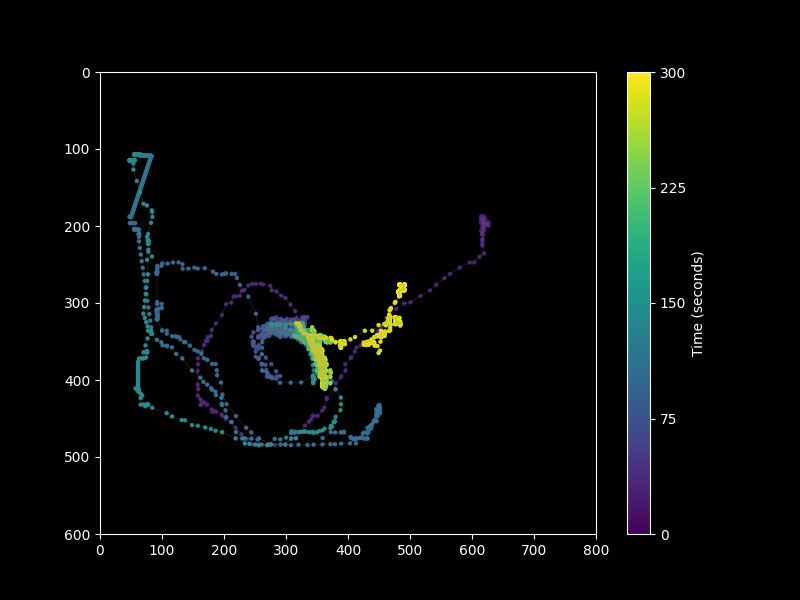

In [12]:
query = "Plot the trajectory of the animal using the animal center and color it by time"
qa_message = amadeus.step(query)
qa_message = parse_result(amadeus, qa_message)

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

doing active forgetting


INFO:httpx:HTTP Request: POST https://openrouter.ai/api/v1/chat/completions "HTTP/1.1 200 OK"


current total cost 0 $
current input tokens 3871
current accumulated tokens 22924


```python
def get_roi_transition_events(identifier):
    """
    Find events where the animal transitions from ROI0 to ROI1.
    
    Parameters:
    ----------
    identifier: Identifier. Contains video, keypoint, and config info
    
    Returns:
    -------
    List[Event]: Composite events representing transitions from ROI0 to ROI1
    """
    analysis = create_analysis(identifier)
    
    # Get exit events from ROI0 (overlap becomes False)
    roi0_exit_events = analysis.get_animals_object_events(
        object_name='ROI0',
        query='overlap == False',
        min_window=1,
        max_window=100000
    )
    
    # Get entry events into ROI1 (overlap becomes True)
    roi1_entry_events = analysis.get_animals_object_events(
        object_name='ROI1',
        query='overlap == True',
        min_window=1,
        max_window=100000
    )
    
    # Find sequential events where exit from ROI0 is followed by entry into ROI1
    composite_events = analysis.get_composite_events(
        events_A=roi0_exit_events,
        events_B=roi1_entry_events,
        composition_type='sequential',
        max_interval_between_sequential_events=30  # Adjust based on frame rate
    )
    
    return composite_events
```

Key implementation details:
1. **Event Detection**:
   - Uses `get_animals_object_events` to detect:
     - Exit from ROI0 (`overlap == False`)
     - Entry into ROI1 (`overlap == True`)
   - Combines these events using `get_composite_events` with 'sequential' logic

2. **Parameters**:
   - `max_interval_between_sequential_events=30` (default 15 in example, but increased for biological plausibility)
   - `min_window=1` to capture instantaneous state changes
   - `max_window=100000` to capture all possible events

3. **Assumptions**:
   - The animal must exit ROI0 before entering ROI1
   - Transition window is set to 30 frames (adjust based on frame rate)
   - Uses default smoothing window size (11 frames) from API docs

4. **Compliance**:
   - Follows rule 4 (single function with identifier parameter)
   - Uses only provided API functions
   - Adheres to object naming constraints (ROI0-ROI3)

To use this function:
```python
transitions = get_roi_transition_events(identifier)
for event in transitions:
    print(f"Transition from ROI0 to ROI1 occurred between frames {event.start} and {event.end}")
```

Note: The actual transition time would be between the end of the ROI0 exit event and the start of the ROI1 entry event. To get precise timing, you would need to calculate the midpoint between these two events.

videos generated to defaultdict(<class 'list'>, {<amadeusgpt.behavior_analysis.identifier.Identifier object at 0x331abc690>: ['results/maushaus_trimmed_get_roi_transition_events_video_0.mp4', 'results/maushaus_trimmed_get_roi_transition_events_video_1.mp4', 'results/maushaus_trimmed_get_roi_transition_events_video_2.mp4', 'results/maushaus_trimmed_get_roi_transition_events_video_3.mp4']})
Open it with media player if it does not properly display in the notebook


[<amadeusgpt.analysis_objects.event.Event object at 0x331e8e490>, <amadeusgpt.analysis_objects.event.Event object at 0x331e7cf10>, <amadeusgpt.analysis_objects.event.Event object at 0x331e9d050>, <amadeusgpt.analysis_objects.event.Event object at 0x331e9d610>]

[<amadeusgpt.analysis_objects.event.Event object at 0x331e8e490>, <amadeusgpt.analysis_objects.event.Event object at 0x331e7cf10>, <amadeusgpt.analysis_objects.event.Event object at 0x331e9d050>, <amadeusgpt.analysis_objects.event.Event object at 0x331e9d610>]

[<amadeusgpt.analysis_objects.event.Event object at 0x331e8e490>, <amadeusgpt.analysis_objects.event.Event object at 0x331e7cf10>, <amadeusgpt.analysis_objects.event.Event object at 0x331e9d050>, <amadeusgpt.analysis_objects.event.Event object at 0x331e9d610>]

[<amadeusgpt.analysis_objects.event.Event object at 0x331e8e490>, <amadeusgpt.analysis_objects.event.Event object at 0x331e7cf10>, <amadeusgpt.analysis_objects.event.Event object at 0x331e9d050>, <amadeusgpt.analysis_objects.event.Event object at 0x331e9d610>]

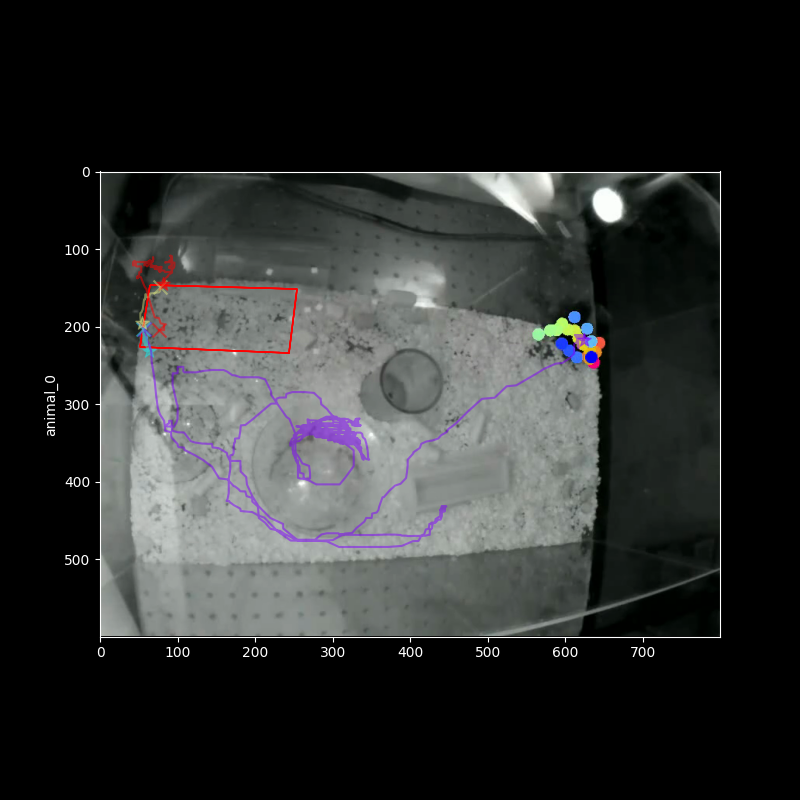

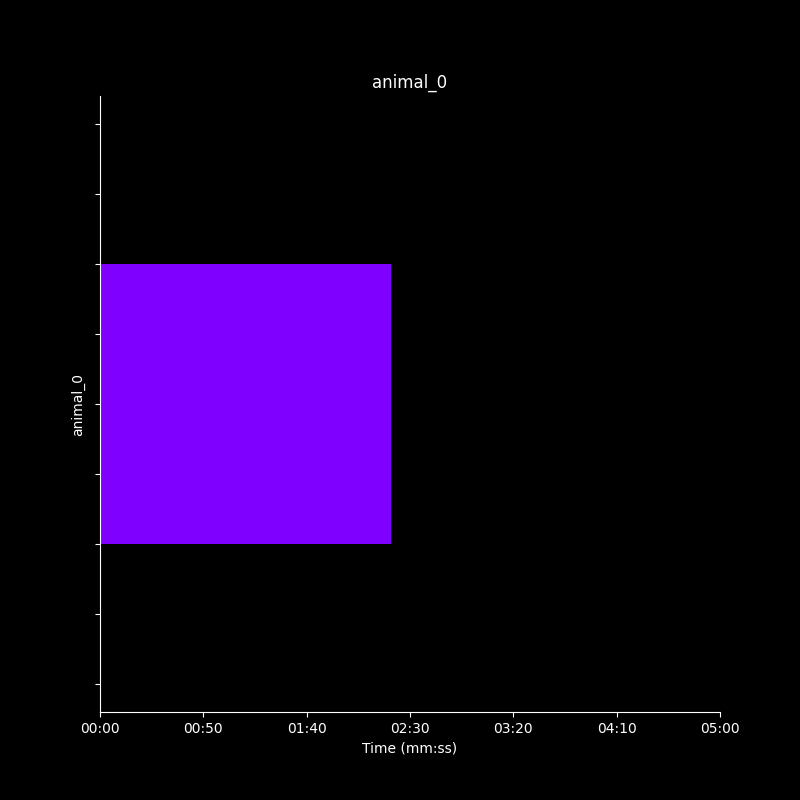

In [13]:
query = "When does the mouse move from ROI0 to ROI1?"
qa_message = amadeus.step(query)
qa_message = parse_result(amadeus, qa_message)

### For a sequential event such as moving from ROI0 to ROI1, you will perhaps need to describe the interval between two events. If you got empty events above, try this below

INFO:httpx:HTTP Request: POST https://api.openai.com/v1/embeddings "HTTP/1.1 200 OK"
INFO:httpx:HTTP Request: POST https://api.openai.com/v1/chat/completions "HTTP/1.1 200 OK"


current total cost 0.0915 $
current input tokens 3654
current accumulated tokens 15343
doing active forgetting


To determine when the mouse moves from ROI0 to ROI1 with an interval of less than 100 frames, we can use the `get_composite_events` function with the `max_interval_between_sequential_events` parameter set to 100. Let's proceed with the code:

```python
def get_movement_from_ROI0_to_ROI1_within_100_frames(identifier):
    '''
    Parameters:
    ----------
    identifier: Identifier. Contains information about the video, keypoint and config
    '''
    # Create an instance of AnimalBehaviorAnalysis
    analysis = create_analysis(identifier)
    
    # Get events where the animal is in ROI0
    in_ROI0_events = analysis.get_animals_object_events(object_name='ROI0', query='overlap==True', negate=False)
    
    # Get events where the animal is in ROI1
    in_ROI1_events = analysis.get_animals_object_events(object_name='ROI1', query='overlap==True', negate=False)
    
    # Find events where the animal moves from ROI0 to ROI1 within 100 frames
    movement_events = analysis.get_composite_events(events_A=in_ROI0_events, 
                                                    events_B=in_ROI1_events, 
                                                    composition_type='sequential', 
                                                    max_interval_between_sequential_events=100)
    
    return movement_events
```

This function will return a list of events where the mouse moves from ROI0 to ROI1 with an interval of less than 100 frames. The `get_composite_events` function is used with the `sequential` composition type and the `max_interval_between_sequential_events` parameter set to 100 to capture these specific movements.

videos generated to defaultdict(<class 'list'>, {<amadeusgpt.behavior_analysis.identifier.Identifier object at 0x31df6ebd0>: ['results/maushaus_trimmed_get_movement_from_ROI0_to_ROI1_within_100_frames_video_0.mp4']})
Open it with media player if it does not properly display in the notebook


[<amadeusgpt.analysis_objects.event.Event object at 0x334797530>]

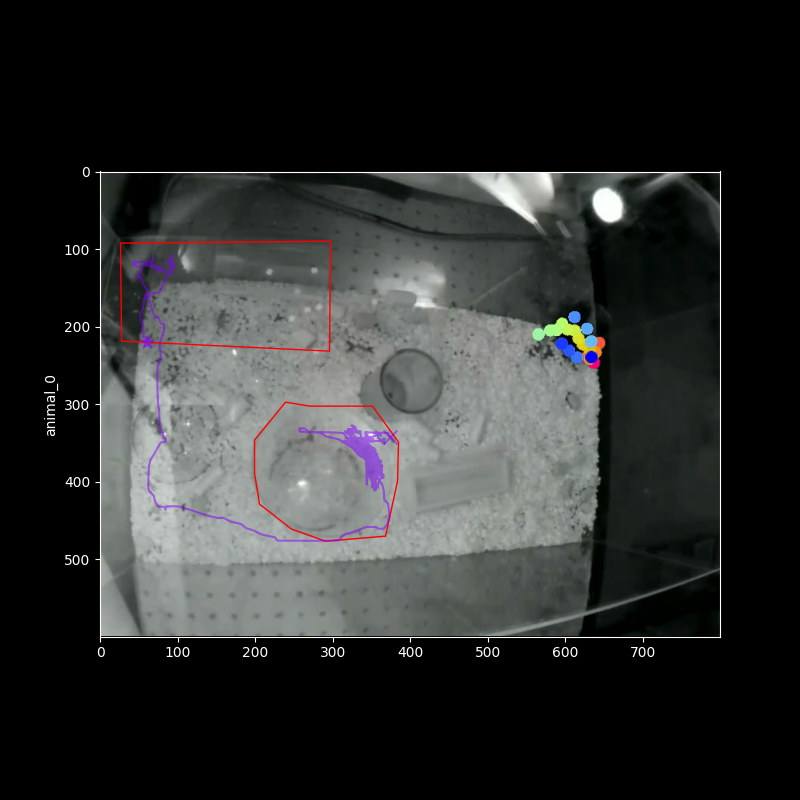

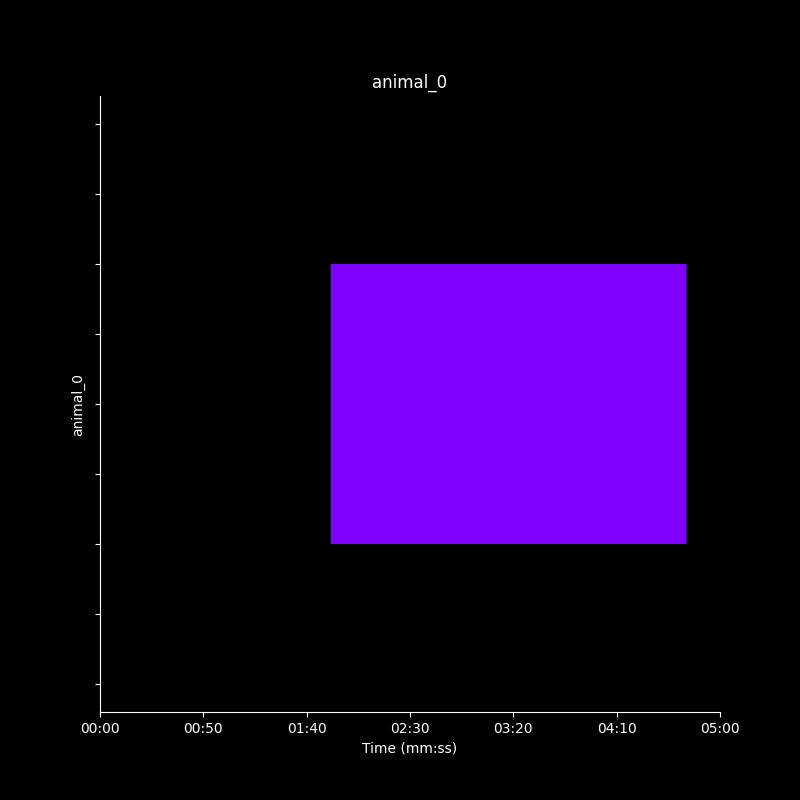

In [12]:
query = "When does the mouse move from ROI0 to ROI1. The interval should be less than 100 frames"
qa_message = amadeus.step(query)
qa_message = parse_result(amadeus, qa_message)

### You can get a list of binary masks (equivalent to ethogram) for the underlying behavior, if your query is about retriving a described behavior

In [ ]:
# the return masks is of shape (num_of_events, video_length)
# where each boolean array of (video_length,) is binary where True indicates whether the behavior is happening at that frame
masks = qa_message.get_masks()
print (masks)